In [1]:
# Activate environment in current folder
using Pkg
Pkg.activate(pwd())

  Activating project at `~/Desktop/School Stuff/Winter 2024/Research/2024-frequency-memory`


In [2]:
# Import packages
using Dates, Plots, DifferentialEquations, LaTeXStrings, Statistics, Measures, Peaks, DelimitedFiles, Roots, QuadGK, SpecialFunctions, Interpolations

In [440]:
function integrate(f, p, u0, times; cb = nothing, transient = 0, int_method = Vern9(), dt = false)
    # Helper function to integrate a system of ode
    
    prob = ODEProblem(f, u0, (times[1], times[end]+transient), p, callback = cb)
    sol = solve(prob, int_method, dt = dt, saveat = times .+ transient)

    return sol
end

function palette_from_hex(hex_list)
    # Function that returns a Julia color palette based on a list of hex codes
    hash_list = [string("#", i) for i in hex_list]
    
    pal = []
    for i in hash_list
        push!(pal, parse(Colorant, i))
    end
    return palette(pal)
end

custom_palette = palette_from_hex(["009afa","e36f47","3ea44d","c371d2","ac8e18", "03aaae","ed5e93","c68225","03a98d","8e971d", "03a9cc","9b7fe9","618df6","f06073","dd65b6", "6c9f33","f61067","f7aef8","72ddf7","5e239d", "80ff72","00afb9","685044","fed9b7","f07167"])

default(
    linewidth = 3, 
    markerstrokewidth = 0,
    palette = palette_from_hex(["009afa","e36f47","3ea44d","c371d2","ac8e18", "03aaae","ed5e93","c68225","03a98d","8e971d", "03a9cc","9b7fe9","618df6","f06073","dd65b6", "6c9f33","f61067","f7aef8","72ddf7","5e239d", "80ff72","00afb9","685044","fed9b7","f07167"])
)


# Plotting formatter
cos_func(x, y) = (x, cos(y))
plt_mod = [(cos_func, 0, 1), (cos_func, 0, 2), 3];

In [441]:
# coupling function
function coupling_atan(x)
    return atan(8*(1-x))/8 + x
end

# gaussian function
function gaussian(x, mu, sig)
    return exp(-((x-mu)^2)/(2*sig^2))/sqrt(2*π*sig^2)
end

function der_gaussian(x, mu, sig)
    return (mu - x)*exp((-(x-mu)^2)/(2*sig^2))/(sqrt(2*π)*sig^3)
end

der_gaussian (generic function with 1 method)

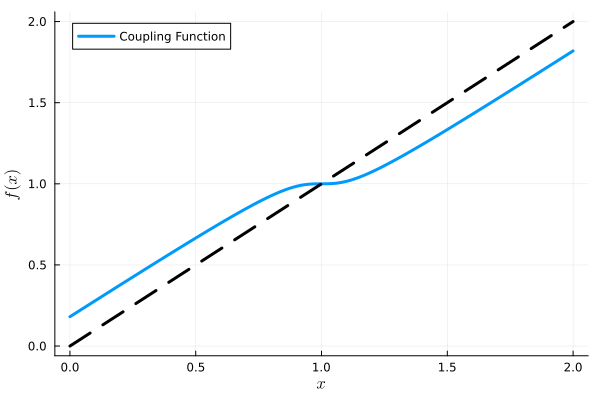

In [442]:
# Plot coupling function
x = 0:0.01:2
plot(coupling_atan, x, xlabel = L"x", ylabel = L"f(x)", label = "Coupling Function")
plot!(x->x, x, label = nothing, linestyle = :dash, color = :black)
plot!()

### fig 8 comparison

In [98]:
# Pulsatile Core
function f_pulse_core(du, u, p, t)
    du[1] = 2*π*coupling_atan(u[3]) + p[2]*sin(u[2] - u[1])
    du[2] = 2*π*p[1]
    du[3] = -u[3]*p[3]
end

# Direct core
function f_direct_core(du, u, p, t)
    du[1] = 2*π*coupling_atan(u[3]) + p[2]*sin(u[2] - u[1])
    du[2] = 2*π*p[1]
    du[3] = (du[1]/(2*π)-u[3])*p[3]
end

# Pulsatile Frequency
function f_pulse_frequency(du, u, p, t)
    du[1] = 2*π*coupling_atan(u[3]) 
    du[2] = 2*π*p[1]
    du[3] = -u[3]*p[3] + p[2]*sin(u[2])*u[3]
end

f_pulse_frequency (generic function with 1 method)

In [99]:
# TOP PANNEL (DIRECT CORE)
# Parameters
p = [0.9, 0, 1]
u0 = [0, 0.0, 2]

# Times
t_step = 0.0005
final_t = 10
times = 0:t_step:final_t


# Integration
sol = integrate(f_direct_core, p, u0, times, transient = 0/p[1])

# Storing arrays with begining and end of cycles
tt = times
ϕt = sol[1, :]
xt = sol[3, :];
θt = sol[2, :];

# Save data
#writedlm("data/fig2_a_top.csv", hcat(tt, cos.(ϕt), xt))

plt1 = plot(tt, cos.(ϕt), label = L"\cos \phi", lc = 1, xaxis = false, ylabel = "Ampliude", legend = false)
plot!(plt1, tt, xt, label = L"x", lc = 3);

In [100]:
# BOTTOM PANNEL (PULSATILE CORE)

# Parameters
p = [0.9, 0, 1]
u0 = [0, 0.0, 2.5]


# Pulse Callback
condition(u,t,integrator) = sin(u[1]/2)
affect!(integrator) = integrator.u[3] += p[3]
cb = ContinuousCallback(condition, affect!, save_positions=(false,false))


# Times
t_step = 0.0005
final_t = 10
times = 0:t_step:final_t


# Integration
sol = integrate(f_pulse_core, p, u0, times, transient = 0/p[1], cb = cb)

# Storing arrays with begining and end of cycles
tt = times
ϕt = sol[1, :]
xt = sol[3, :];
θt = sol[2, :];

# Save data
##writedlm("data/fig2_a_bot.csv", hcat(tt, cos.(ϕt), xt))

plt2 = plot(tt, cos.(ϕt), label = L"\cos \phi", lc = 1, xlabel = "Time", ylabel = "Amplitude")
plot!(plt2, tt, xt, label = L"x", lc = 3);

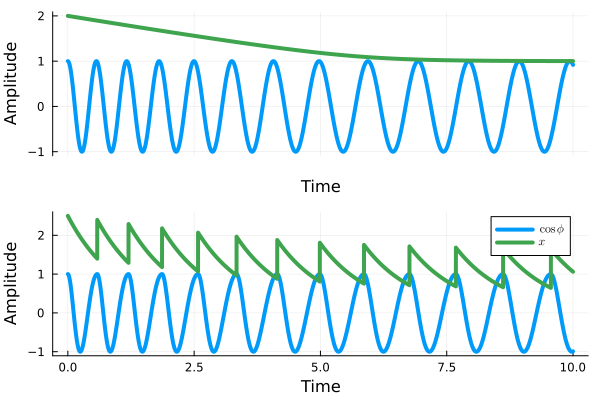

In [101]:
plot(plt1, plt2, layout = (2, 1), xlabel = "Time", ylabel = "Amplitude")

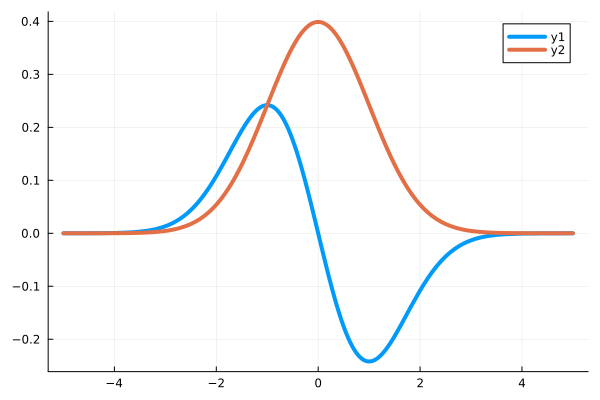

In [102]:
function der_gaussian(x, mu, sig)
    return (mu - x)*exp((-(x-mu)^2)/(2*sig^2))/(sqrt(2*π)*sig^3)
end

function gaussian(x, mu, sig)
    return exp(-((x-mu)^2)/(2*sig^2))/sqrt(2*π*sig^2)
end

plot(x->der_gaussian(x, 0, 1))
plot!(x->gaussian(x, 0, 1))

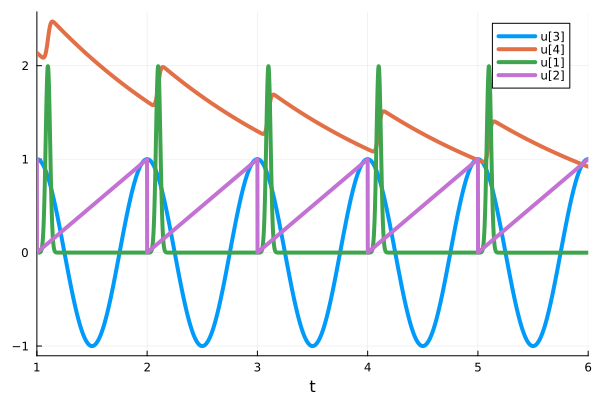

In [119]:

function pulse_test(du, u, p, t)
    du[1] = der_gaussian(mod(u[2], 1), p[1], p[2])
    du[2] = 1
    du[3] = 2*π
    du[4] = 0.5*(gaussian(mod(u[2], 1), p[1], p[2]) - u[4])
end

# Pulse Callback
condition(u,t,integrator) = sin(u[3]/2)
affect!(integrator) = integrator.u[2] = 0
cb = ContinuousCallback(condition, affect!, save_positions=(false,false))

sol = integrate(
    pulse_test, 
    [
        0.1,    
        0.02
    ], 
    [
        0.0, 
        0, 
        0, 
        3
    ],
    0:0.001:5,
    cb = cb,
    transient = 1
)

plot(
    sol, 
    idxs = [((x, y)->(x, cos(y)), 0, 3), 4, ((x, y)->(x, y/10), 0, 1), 2]
#ylims = [-0.1, 2]
)

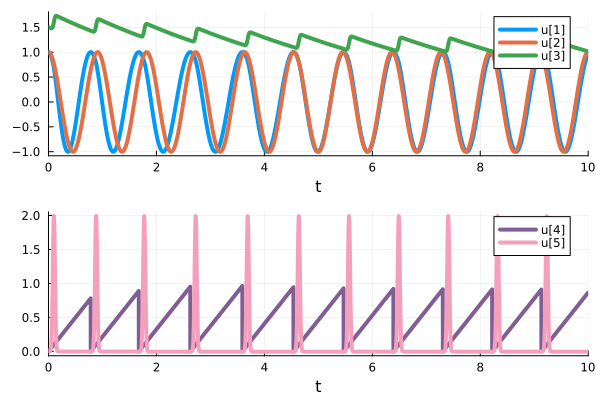

In [325]:
# Now we actually try to verify the gaussian pulse entrainment:

function f(du, u, p, t)
    du[1] = 2*π*coupling_atan(u[3]) + p[2]*sin(u[2]-u[1])       # phi
    du[2] = 2*π*p[1]                                            # theta
    du[3] = p[3]*(gaussian(mod(u[4], 1), p[4], p[5]) - u[3])    # x
    du[4] = 1.0                                                 # "time"
    du[5] = der_gaussian(mod(u[4], 1), p[4], p[5])              # pulses
end

# Pulse Callback
condition(u,t,integrator) = sin(u[1]/2)
affect!(integrator) = integrator.u[4] = 0
cb = ContinuousCallback(condition, affect!, save_positions=(false,false))

# Parameters 
p = [
    1.1,
    1.5,
    0.3,
    0.1, 
    0.02
]

# Initial conditions
u0 = [
    0.0,    # phi
    0.0,    # theta
    1.5,    # x
    0.0,    # "time"
    0.0,    # pulses
]

# solve problem
sol = integrate(f, p, u0, 0:0.001:10, cb = cb, transient = 0)

# plot
plt1 = plot(
    sol, 
    idxs = [(cos_func, 0, 1), (cos_func, 0, 2), 3]
#ylims = [-0.1, 2]
)

plt2 = plot(
    sol, 
    idxs = [4, ((x, y)->(x, y/10), 0, 5)],
    palette = palette_from_hex(["805d93","f49fbc"])
#ylims = [-0.1, 2]
)

plot(plt1, plt2, layout = (2, 1))



In [371]:
# Now we actually try to verify the gaussian pulse entrainment:

function f(du, u, p, t)
    du[1] = 2*π*coupling_atan(u[3]) + p[2]*sin(u[2]-u[1])       # phi
    du[2] = 2*π*p[1]                                            # theta
    du[3] = p[3]*(gaussian(mod(u[4], 1), p[4], p[5]) - u[3])    # x
    du[4] = 1.0                                                 # "time"
    du[5] = der_gaussian(mod(u[4], 1), p[4], p[5])              # pulses
end

function sim_gaussian_pulse(sig)

    # half width (in time) of the pulse
    hw_pulse = 0.25

    # Pulse Callback
    condition(u,t,integrator) = sin((u[1] + 2*π*hw_pulse)/2)
    affect!(integrator) = integrator.u[4] = 0
    cb = ContinuousCallback(condition, affect!, save_positions=(false,false))

    # Parameters 
    p = [
        1,
        0,
        0.5,
        hw_pulse, 
        sig
    ]

    # Initial conditions
    u0 = [
        0.0,    # phi
        0.0,    # theta
        1.5,    # x
        0.0,    # "time"
        0.0,    # pulses
    ]

    # times 
    times = 0:0.001:3

    # solve problem
    sol = integrate(f, p, u0, times, cb = cb, transient = 100, int_method = Euler(), dt = 0.001)

    return sol, times
end

sol, times = sim_gaussian_pulse(0.05)

phi = cos.(sol[1, :])
theta = cos.(sol[2, :])
x = sol[3, :]
pulses = sol[5, :]

plt1 = plot( ylabel = "Amplitude", xlabel = "Time")
plot!(plt1, times, phi, label = L"\cos(\phi)")
#plot!(plt1, times, theta, label = L"\cos(\theta)")
plot!(plt1, times, x, label = L"x", lc = 3)

plt2 = plot(xaxis = false)
plot!(plt2, times, pulses, lc = 13, label = "Pulses")
l = @layout [a{0.4h} ; a]
soft_plt = plot(plt2, plt1, layout = l, grid = false,  bottom_margin = -7mm)

sol, times = sim_gaussian_pulse(0.005)

phi = cos.(sol[1, :])
theta = cos.(sol[2, :])
x = sol[3, :]
pulses = sol[5, :]

plt1 = plot( xlabel = "Time")
plot!(plt1, times, phi, label = L"\cos(\phi)")
#plot!(plt1, times, theta, label = L"\cos(\theta)")
plot!(plt1, times, x, label = L"x", lc = 3)

plt2 = plot(xaxis = false)
plot!(plt2, times, pulses, lc = 13, label = "Pulses")
l = @layout [a{0.4h} ; a]
hard_plt = plot(plt2, plt1, layout = l, grid = false, bottom_margin = -7mm, legend = false);

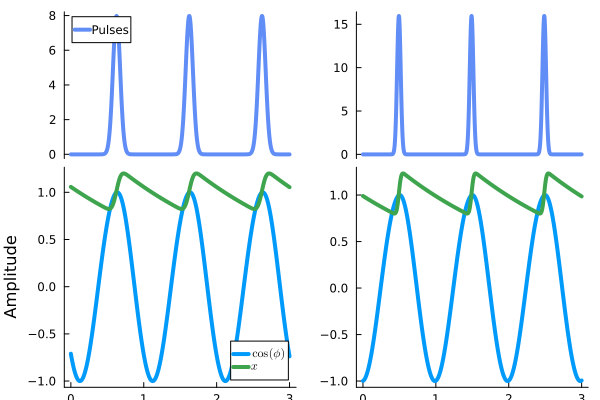

In [367]:
plot(soft_plt, hard_plt)

In [5]:

function unentrained_stable(alphas, pulse_width)
    

    pers_list = []

    for alpha in alphas

        function f(du, u, p, t)
            du[1] = 2*π*coupling_atan(u[3]) + p[2]*sin(u[2]-u[1])       # phi
            du[2] = 2*π*p[1]                                            # theta
            du[3] = p[3]*(gaussian(mod(u[4], 1), p[4], p[5]) - u[3])    # x
            du[4] = 1.0                                                 # "time"
            du[5] = der_gaussian(mod(u[4], 1), p[4], p[5])              # pulses
        end
        
        # Pulse Callback
        condition(u,t,integrator) = sin(u[1]/2)
        affect!(integrator) = integrator.u[4] = 0
        cb = ContinuousCallback(condition, affect!, save_positions=(false,false))

        # Parameters 
        p = [
            1,
            0,
            alpha,
            0.1, 
            pulse_width
        ]

        # Initial conditions
        u0 = [
            0.0,    # phi
            0.0,    # theta
            1.5,    # x
            0.0,    # "time"
            0.0,    # pulses
        ]
        # times
        times = 0:0.001:3

        # solve problem
        sol = integrate(f, p, u0, times, cb = cb, transient = 400, int_method = Euler(), dt = 0.001)

        id = argmaxima(sol[3, :])
        
        push!(pers_list, sol.t[id[3]] - sol.t[id[2]])
        

    end
    return pers_list
end

# list of pulse sizes
alpha_list = LinRange(0.5, 50, 100)

# list of stable periods for the given list of pulse sizes
per_list_soft = unentrained_stable(alpha_list, 0.05)
per_list_hard = unentrained_stable(alpha_list, 0.005);

UndefVarError: UndefVarError: `integrate` not defined

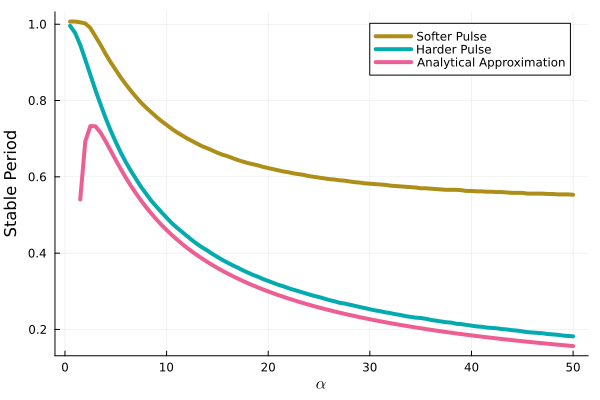

In [373]:
plt1 = plot(xlabel = L"\alpha", ylabel = "Stable Period", palette = custom_palette[5:8])
plot!(plt1, alpha_list, per_list_soft, label = "Softer Pulse")
plot!(plt1, alpha_list, per_list_hard, label = "Harder Pulse")
plot!(plt1, x->2*log(x)/x, alpha_list[3:end], label = "Analytical Approximation")

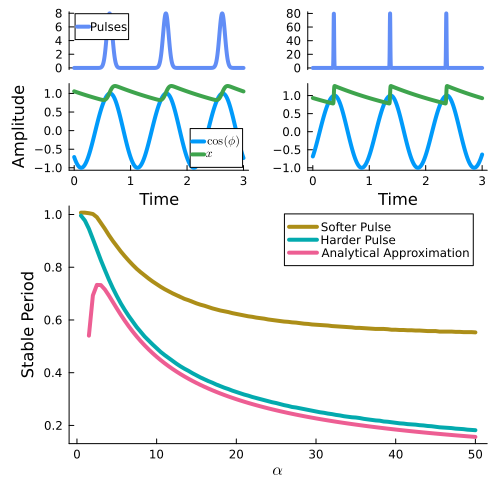

In [374]:
l = @layout [ [a a] ; a{0.6h}]
kk  = plot(soft_plt, hard_plt, plt1, layout = l, size = (500, 500), grid = false)

### Entrainment with soft pulse

In [326]:
function sim_entrainment_gaussian_pulse(sig)

    # half width (in time) of the pulse
    hw_pulse = 0.25

    # Pulse Callback
    condition(u,t,integrator) = sin((u[1] + 2*π*hw_pulse)/2)
    affect!(integrator) = integrator.u[4] = 0
    cb = ContinuousCallback(condition, affect!, save_positions=(false,false))

    # Parameters 
    p = [
        1.2,
        1.,
        0.5,
        hw_pulse, 
        sig
    ]

    # Initial conditions
    u0 = [
        0.0,    # phi
        0.0,    # theta
        1.,    # x
        0.0,    # "time"
        0.0,    # pulses
    ]

    # times 
    times = 0:0.001:8

    # solve problem
    sol = integrate(f, p, u0, times, cb = cb, transient = 200/p[1], int_method = Euler(), dt = 0.001)
    #sol = integrate(f, p, u0, times, cb = cb, transient = 10, int_method = Vern9())

    section = 0:1/p[1]:200/p[1]
    sol_section = integrate(f, p, u0, section, cb = cb, transient = 0, int_method = Euler(), dt = 0.001)

    return sol, times, mod.(sol_section[1, :], 2*π)
end

sol, times, section = sim_entrainment_gaussian_pulse(0.05)

phi = cos.(sol[1, :])
theta = cos.(sol[2, :])
x = sol[3, :]
pulses = sol[5, :];


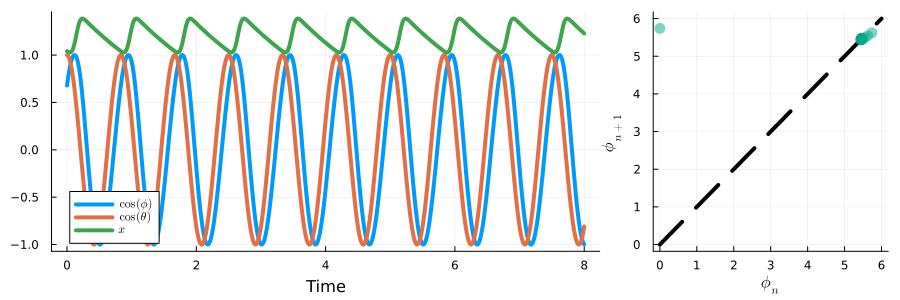

In [327]:
plt_entrainment = plot( xlabel = "Time")
plot!(plt_entrainment, times, phi, label = L"\cos(\phi)")
plot!(plt_entrainment, times, theta, label = L"\cos(\theta)")
plot!(plt_entrainment, times, x, label = L"x", lc = 3)

plt_poinc = scatter(xlabel = L"\phi_n", ylabel = L"\phi_{n+1}")
plot!(plt_poinc, x->x,0:2*π, linestyle = :dash, color = :black, label = nothing)
scatter!(plt_poinc, section[1:end-1], section[2:end], alpha = 0.5, label = nothing, mc = 9, markersize = 6)

l = @layout [a{0.7w} a]
plot(plt_entrainment, plt_poinc, layout = l, size = (900, 300), bottom_margin = 5mm)

### Phase of entrainement with soft pulse

In [4]:
function coupling_atan(x::Float64, c1::Float64, c2::Float64)
    return atan(c2*(1-x))/c1 + x
end

coupling_atan (generic function with 1 method)

In [268]:
# defining some functions to detect the phase differences
function center_phase(x; circ = 2*π)
    mod(x + circ/2, circ) - circ/2
end

function circ_distance(x1, x2; circ = 2*π)
    foo1 =  - center_phase.(x1) + center_phase.(x2)
    foo1 = mod.(foo1 .+ π, 2*π) .- π
end


x1 = (0:2*π:2*π*20) .+ rand()*2*π*10
x2 = x1 + randn(size(x1))*1.5
dist = circ_distance(
    x1,
    x2  
)

scatter(center_phase.(x1), markersize = 10)
scatter!(center_phase.(x2), markersize = 7)
scatter!(dist, label = "dist", color = :purple)
hline!([π/2, π, 0, -π/2, -π], color = :black, alpha = 0.4);

In [267]:
function model_dirac_pulse(c1, c2, omega, k, alpha; thresh = 0.1)
    # function that detects if the system is entrained and then output the phase of entrainement

    function f(du, u, p, t)
        du[1] = 2*π*coupling_atan(u[3], c1, c2) + p[2]*sin(u[2]-u[1])       # phi
        du[2] = 2*π*p[1]                                            # theta
        du[3] = p[3]*( - u[3])    # x
    end

    # Parameter
    p = [
        omega, 
        k,
        alpha,
    ]
    

    

    # Pulse Callback
    condition(u,t,integrator) = sin((u[1])/2)
    affect!(integrator) = integrator.u[3] += p[3]
    cb = ContinuousCallback(condition, affect!, save_positions=(false,false))



    # Initial conditions
    u0 = [
        rand()*2*π,
        0,
        1.2
    ]

    # Times 
    final_time = 20/p[1]
    times = 0:0.001:final_time

    # Integration
    sol = integrate(f, p, u0, times, transient = 0, cb = cb, int_method = Euler(), dt = 0.0001)

    plt1_1 = plot()
    plt1 = plot(sol, idxs = [(cos_func, 0, 1), (cos_func, 0, 2), 3])

    
    

    # now look at poincarre section
    times = 0:1/p[1]:final_time
    sol = integrate(f, p, u0, times, transient = 0, cb = cb, int_method = Euler(), dt = 0.0001)
    scatter!(sol, idxs = [(cos_func, 0, 1), (cos_func, 0, 2), 3])
    dist = circ_distance(sol[1, :], sol[2, :])
    plt2 = scatter(sol.t, dist, label = "Phase difference")

    plot(plt1, plt1_1, plt2, layout = (3,1))

    savefig(string("test_figs/", "test", ".png"))
    #savefig(string("test_figs/", now(), ".png"))



end

model_dirac_pulse(
    8., 
    53., 
    1.2,
    1.35,
    0.1
)

"/Users/christiandenis/Desktop/School Stuff/Winter 2024/Research/2024-frequency-memory/test_figs/test.png"

In [293]:
function model_soft_pulse(c1, c2, omega, k, alpha; thresh = 0.1)
    # function that detects if the system is entrained and then output the phase of entrainement

    function f(du, u, p, t)
        du[1] = 2*π*coupling_atan(u[3], c1, c2) + p[2]*sin(u[2]-u[1])       # phi
        du[2] = 2*π*p[1]                                            # theta
        du[3] = p[3]*(gaussian(u[4], p[4], p[5]) - u[3])    # x
        du[4] = 1.0                                                 # "time"
        du[5]= der_gaussian(u[4], p[4], p[5])
    end

    # half width (in time) of the pulse
    hw_pulse = 0.25
    

    # Pulse Callback
    condition(u,t,integrator) = sin((u[1] + hw_pulse*2*π)/2)
    affect!(integrator) = integrator.u[4] = 0
    cb = ContinuousCallback(condition, affect!, save_positions=(false,false))

    # Parameter
    p = [
        omega, 
        k,
        alpha,
        hw_pulse, 
        0.005
    ]

    # Initial conditions
    u0 = [
        0,
        0,
        p[1],
        0,
        0
    ]

    # Times 
    final_time = 40/p[1]
    times = 0:0.0001:final_time

    # Transient
    trans = 1000/p[1]

    # Integration
    sol = integrate(f, p, u0, times, transient = trans, cb = cb, int_method = Euler(), dt = 0.001)

    plt1_1 = plot(sol, idxs = [5])
    plt1 = plot(sol, idxs = [(cos_func, 0, 1), (cos_func, 0, 2), 3, 4])

    
    

    # now look at poincarre section
    times = 0:1/p[1]:final_time
    sol = integrate(f, p, u0, times, transient = trans, cb = cb, int_method = Euler(), dt = 0.001)
    scatter!(sol, idxs = [(cos_func, 0, 1), (cos_func, 0, 2), 3, 4])
    dist = circ_distance(sol[1, :], sol[2, :])
    plt2 = scatter(sol.t, dist, label = "Phase difference")

    plot(plt1, plt1_1, plt2, layout = (3,1))

    savefig(string("test_figs/", "test", ".png"))
    #savefig(string("test_figs/", now(), ".png"))


    return dist[end]
end

model_soft_pulse(
    7.6, 
    53.6, 
    1/1.25,
    1.35,
    0.03
)

pers = LinRange(0.8, 1.25, 5)
phases = [model_soft_pulse(7.6, 53.6, 1/i, 1.35, 0.03) for i in pers]

5-element Vector{Float64}:
  1.157832141137078
  1.0054683162925357
 -0.5740418442828741
 -1.0508685632294146
 -1.1335665205360783

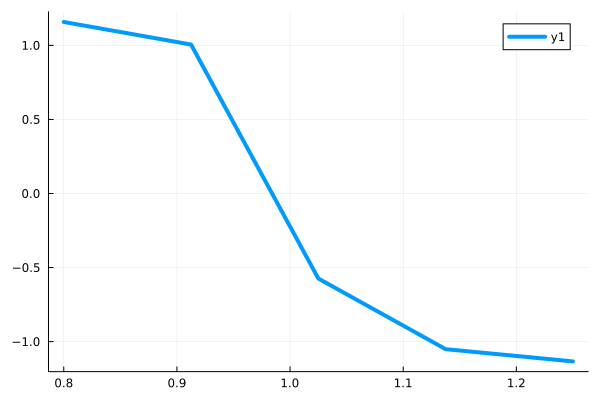

In [294]:
plot(pers, phases)

In [300]:
# Defining functions for pulsatile model:
function model_pulse(c1, c2, p; thresh = 0.1)
    # Model function for the phase difference as a function of period of entrainment
    # for the pulsatile adaptive system

    # Defining differential equations
    function f(du, u, p, t)
        du[1] = 2*π*coupling_atan(u[3], c1, c2) + p[2]*sin(u[2] - u[1])
        du[2] = 2*π*p[1]
        du[3] = (-u[3])*p[3]
    end
    

    # Initial conditions (adjusted to entrain)
    u0 = [0., 0.0, 4*(p[1] - 1)+1]

    condition(u,t,integrator) = sin(u[1]/2)
    affect!(integrator) = integrator.u[3] += p[3]
    cb = ContinuousCallback(condition, affect!, save_positions=(false,false))

    # Check if entrained 
    # Times
    t_step = 1/p[1]
    final_t = 50/p[1]
    times = 0:t_step:final_t
    # Integration
    sol = integrate(f, p, u0, times, transient = 500/p[1], cb = cb)
    # Storing arrays with begining and end of cycles
        tt = times
        ϕt = sol[1, :]
        xt = sol[3, :];
        θt = sol[2, :];
        #println(mod.(ϕt, 2*π))
    # Finding the variation of the phases at every pulse
        var = abs(maximum(mod.(ϕt, 2*π)) - minimum(mod.(ϕt, 2*π)))
        
    # Check if entrained, if so, compute entrainment phase
    if var <= thresh
        # Times
        final_t = 3/p[1]
        times = LinRange(0, final_t, 2000)

        # Integration
            sol = integrate(f, p, u0, times, transient = 2000/p[1], cb = cb)

        # Storing arrays with begining and end of cycles
            tt = times
            ϕt = sol[1, :]
            xt = sol[3, :];
            θt = sol[2, :];
            
        # Windowing a single cycle
            pks = (1:length(diff(xt)))[diff(xt) .> 0.001]   # Find the jump discontinuities
            index_start = pks[1] + 1
            index_end = pks[2]
            t = tt[index_start:index_end]
            ϕ = ϕt[index_start:index_end]
            θ = θt[index_start:index_end]
            x = xt[index_start:index_end]

        # Looking at the numerical lag
        lag = t[1]* 2*π*p[1]
        return mod(lag + π, 2*π) - π
    else
        return NaN
    end

end

model_pulse (generic function with 1 method)

In [296]:
# Compute derivatives
function deriv(x, y)
    itp = interpolate((x,), y, Gridded(Linear()));
    return [Interpolations.gradient(itp, i)[1] for i in x]
end

deriv (generic function with 1 method)

In [301]:
# Parameters
p = [
    7.6,
    53.6, 
    1.35, 
    0.03, 
    147.5
]

# Experimental data with scaled period
x_exp = [120, 130, 140, 150, 160, 170, 180];
y_exp = [2.027187397, 2.160626379, 2.273879568, 3.584111975, 4.112952389, 4.212513848, 4.287969912];
y_err = [0.327025498, 0.512021604, 0.938028873, 0.60271112, 0.721615977, 0.538049022, 0.722844131];
y_exp = -y_exp .+ π
x_exp_no_memory = x_exp/144 # Using a better fit for no memory
x_exp = x_exp/p[5]
y_exp_d = deriv(x_exp, y_exp)   # Derivative for experimental data

# Periods for plotting
pers = LinRange(minimum(x_exp), maximum(x_exp), 50)
pers2 = LinRange(minimum(x_exp_no_memory), maximum(x_exp_no_memory), 50)

# Pulsatile (Simulation)
y_pulse_sim = [model_pulse(p[1], p[2], [1/i, p[3], p[4]]) for i in pers]
#y_pulse_sim_d = deriv(pers, y_pulse_sim)

# Soft Pulsatile (Simulation)
#y_soft_pulse_sim = [model_soft_pulse(p[1], p[2], 1/i, p[3], p[4]) for i in pers]
#y_soft_pulse_sim_d = deriv(pers, y_soft_pulse_sim)



50-element Vector{Float64}:
  1.1692570956832444
  1.1598276029761214
  1.1503981102689984
  1.1409686175618763
  1.1315391248547524
  1.1221096321476303
  1.1126801394405073
  1.1032506467333842
  1.0938211540262612
  1.0749621686120152
  ⋮
 -1.0498168547263536
 -1.0592463474334775
 -1.0592463474334757
 -1.0686758401405996
 -1.0781053328477235
 -1.0781053328477235
 -1.0875348255548456
 -1.0875348255548456
 -1.0969643182619677

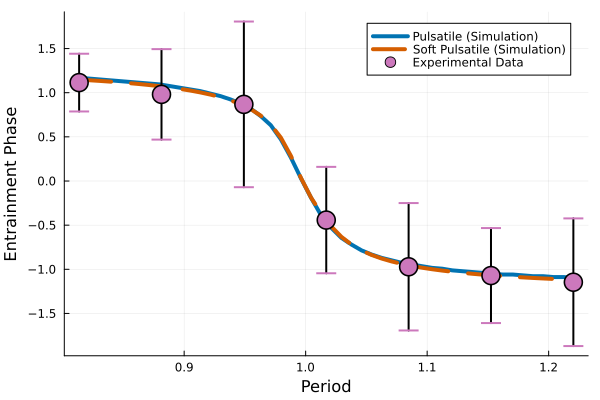

In [316]:
plt1 = plot(ylabel = "Entrainment Phase", palette = :seaborn_colorblind, xlabel = "Period")
plot!(plt1, pers, y_pulse_sim, label = "Pulsatile (Simulation)", lc = 1)
plot!(plt1, pers, y_soft_pulse_sim, label = "Soft Pulsatile (Simulation)", lc = 4, linestyle = :dash)
scatter!(plt1, x_exp, y_exp, yerror = y_err, markersize = 10, label = "Experimental Data", mc = 5, markerstrokewidth = 2)

### Hysteresis

In [443]:
function frequency_ramp(t, time_end)
    if t < time_end
        return t/time_end
    elseif t >= time_end
        return 1.
    end
end



frequency_ramp (generic function with 2 methods)

In [444]:
function f_ramp(du, u, p, t)
    du[1] = 2*π*coupling_atan(u[3]) + p[2]*sin(u[2]-u[1])       # phi
    du[2] = 2*π*(1  + (p[1]-1)*frequency_ramp(t, 7))                    # theta
    du[3] = p[3]*(gaussian(mod(u[4], 1), p[4], p[5]) - u[3])    # x
    du[4] = 1.0                                                 # "time"
    du[5] = der_gaussian(mod(u[4], 1), p[4], p[5])              # pulses
end

f_ramp (generic function with 1 method)

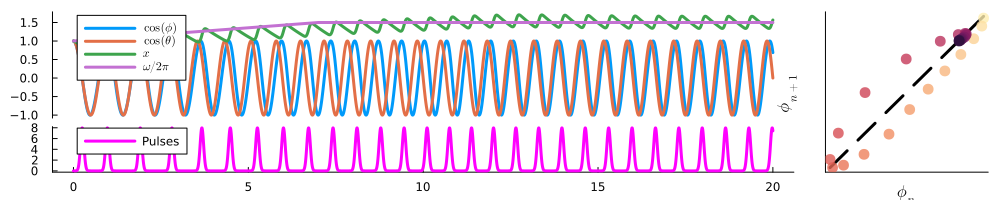

In [497]:
sig = 0.05

# half width (in time) of the pulse
hw_pulse = 0.25

# Pulse Callback
condition(u,t,integrator) = sin((u[1] + 2*π*hw_pulse)/2)
affect!(integrator) = integrator.u[4] = 0
cb = ContinuousCallback(condition, affect!, save_positions=(false,false))

# Parameters 
p = [
    1.5,
    1.7,
    0.5,
    hw_pulse, 
    sig
]

# Initial conditions
u0 = [
    0.0,    # phi
    0.0,    # theta
    1.,    # x
    0.0,    # "time"
    0.0,    # pulses
]

# times 
times = 0:0.001:20

# solve problem
sol = integrate(f_ramp, p, u0, times, cb = cb, transient = 0/p[1], int_method = Euler(), dt = 0.0001)

# get the peaks from theta
peaks_theta = argmaxima(cos.(sol[2, :]))

# get phases from phi 
phases_phi = cos.(sol[1, peaks_theta])

#sol = integrate(f, p, u0, times, cb = cb, transient = 10, int_method = Vern9())

phi = cos.(sol[1, :])
theta = cos.(sol[2, :])
x = sol[3, :]
pulses = sol[5, :];

plt1 = plot(xaxis = false, bottom_margin = -5mm)
plot!(plt1, times, phi, label = L"\cos(\phi)")
plot!(plt1, times, theta, label = L"\cos(\theta)")
plot!(plt1, times, x, label = L"x")
plot!(x->1 + frequency_ramp(x, 7)*0.5, times, label = L"\omega/2\pi")

plt2 = plot(xlabel = "time")
plot!(plt2, times, pulses, label = "Pulses", color = :magenta)

plt3 = plot(xlabel = L"\phi_n", ylabel = L"\phi_{n+1}", ticks = false, legend = false, formatter=(_...) -> "")
plot!(plt3, x->x, [minimum(phases_phi), maximum(phases_phi)], color = :black, linestyle = :dash, label = nothing)
scatter!(plt3, phases_phi[1:end-1], phases_phi[2:end], zcolor = 1:length(phases_phi[1:end-1]),alpha = 0.8, markersize = 6, label = nothing, color = :matter)


l = @layout [[a ; a{0.3h}] a{0.18w}]
top_plt = plot(plt1, plt2, plt3, layout = l, grid = false, size = (1000, 200))




In [446]:
function f_no_ramp(du, u, p, t)
    du[1] = 2*π*coupling_atan(u[3]) + p[2]*sin(u[2]-u[1])       # phi
    du[2] = 2*π*(p[1])                 # theta
    du[3] = p[3]*(gaussian(mod(u[4], 1), p[4], p[5]) - u[3])    # x
    du[4] = 1.0                                                 # "time"
    du[5] = der_gaussian(mod(u[4], 1), p[4], p[5])              # pulses
end

f_no_ramp (generic function with 1 method)

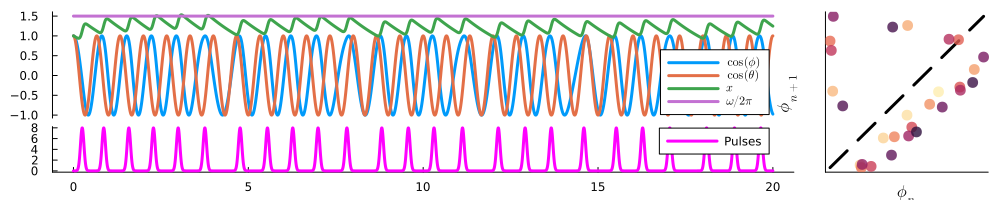

In [498]:
sig = 0.05

# half width (in time) of the pulse
hw_pulse = 0.25

# Pulse Callback
condition(u,t,integrator) = sin((u[1] + 2*π*hw_pulse)/2)
affect!(integrator) = integrator.u[4] = 0
cb = ContinuousCallback(condition, affect!, save_positions=(false,false))

# Parameters 
p = [
    1.5,
    1.7,
    0.5,
    hw_pulse, 
    sig
]

# Initial conditions
u0 = [
    0.0,    # phi
    0.0,    # theta
    1.,    # x
    0.0,    # "time"
    0.0,    # pulses
]

# times 
times = 0:0.001:20

# solve problem
sol = integrate(f_no_ramp, p, u0, times, cb = cb, transient = 0/p[1], int_method = Euler(), dt = 0.0001)

# get the peaks from theta
peaks_theta = argmaxima(cos.(sol[2, :]))

# get phases from phi 
phases_phi = cos.(sol[1, peaks_theta])

#sol = integrate(f, p, u0, times, cb = cb, transient = 10, int_method = Vern9())

phi = cos.(sol[1, :])
theta = cos.(sol[2, :])
x = sol[3, :]
pulses = sol[5, :];

plt1 = plot(xaxis = false, bottom_margin = -5mm)
plot!(plt1, times, phi, label = L"\cos(\phi)")
plot!(plt1, times, theta, label = L"\cos(\theta)")
plot!(plt1, times, x, label = L"x")
plot!(x->1.5, times, label = L"\omega/2\pi")

plt2 = plot(xlabel = "time")
plot!(plt2, times, pulses, label = "Pulses", color = :magenta)

plt3 = plot(xlabel = L"\phi_n", ylabel = L"\phi_{n+1}", ticks = false, legend = false, formatter=(_...) -> "")
plot!(plt3, x->x, [minimum(phases_phi), maximum(phases_phi)], color = :black, linestyle = :dash, label = nothing)
scatter!(plt3, phases_phi[1:end-1], phases_phi[2:end], zcolor = 1:length(phases_phi[1:end-1]),alpha = 0.8, markersize = 6, label = nothing, color = :matter)


l = @layout [[a ; a{0.3h}] a{0.18w}]
bot_plt = plot(plt1, plt2, plt3, layout = l, grid = false, size = (1000, 200))

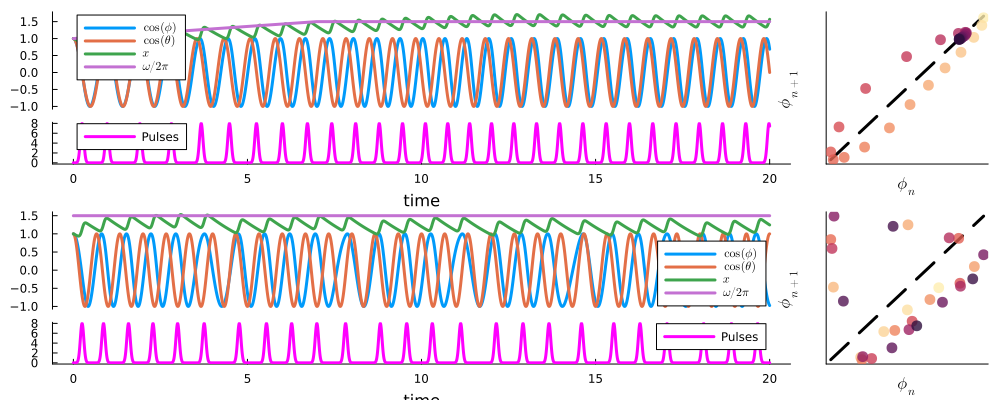

In [501]:
plot(top_plt, bot_plt, layout = (2, 1), size = (1000, 400))